In [1]:
import numpy as np
import matplotlib.pyplot as plt
import hyperspy.api as hs
from cv2 import linearPolar, WARP_FILL_OUTLIERS, WARP_INVERSE_MAP

In [2]:
s = hs.load('/home/rodrigo.souza/Documents/HRTEM/notebooks/ffts_circular_rs2_SVD.hspy')
labels = np.load('/home/rodrigo.souza/Documents/HRTEM/notebooks/labels.npy')
ffts = s.data
ffts.shape

WARNING | Hyperspy | Numba is not installed, falling back to non-accelerated implementation. (hyperspy.decorators:254)
WARNING | Hyperspy | Numba is not installed, falling back to non-accelerated implementation. (hyperspy.decorators:254)
WARNING | Hyperspy | Numba is not installed, falling back to non-accelerated implementation. (hyperspy.decorators:254)
WARNING | Hyperspy | Numba is not installed, falling back to non-accelerated implementation. (hyperspy.decorators:254)
WARNING | Hyperspy | Numba is not installed, falling back to non-accelerated implementation. (hyperspy.decorators:254)
WARNING | Hyperspy | Numba is not installed, falling back to non-accelerated implementation. (hyperspy.decorators:254)
WARNING | Hyperspy | Numba is not installed, falling back to non-accelerated implementation. (hyperspy.decorators:254)
WARNING | Hyperspy | Numba is not installed, falling back to non-accelerated implementation. (hyperspy.decorators:254)
WARNING | Hyperspy | Numba is not installed, fal

(13248, 220, 220)

# Aligning rotation

## Testing for one cluster

In [3]:
selected_label = 7
selected_label_indices = np.where(labels == selected_label)

ffts_oi = ffts[selected_label_indices[0]]
ffts_oi.shape

(62, 220, 220)

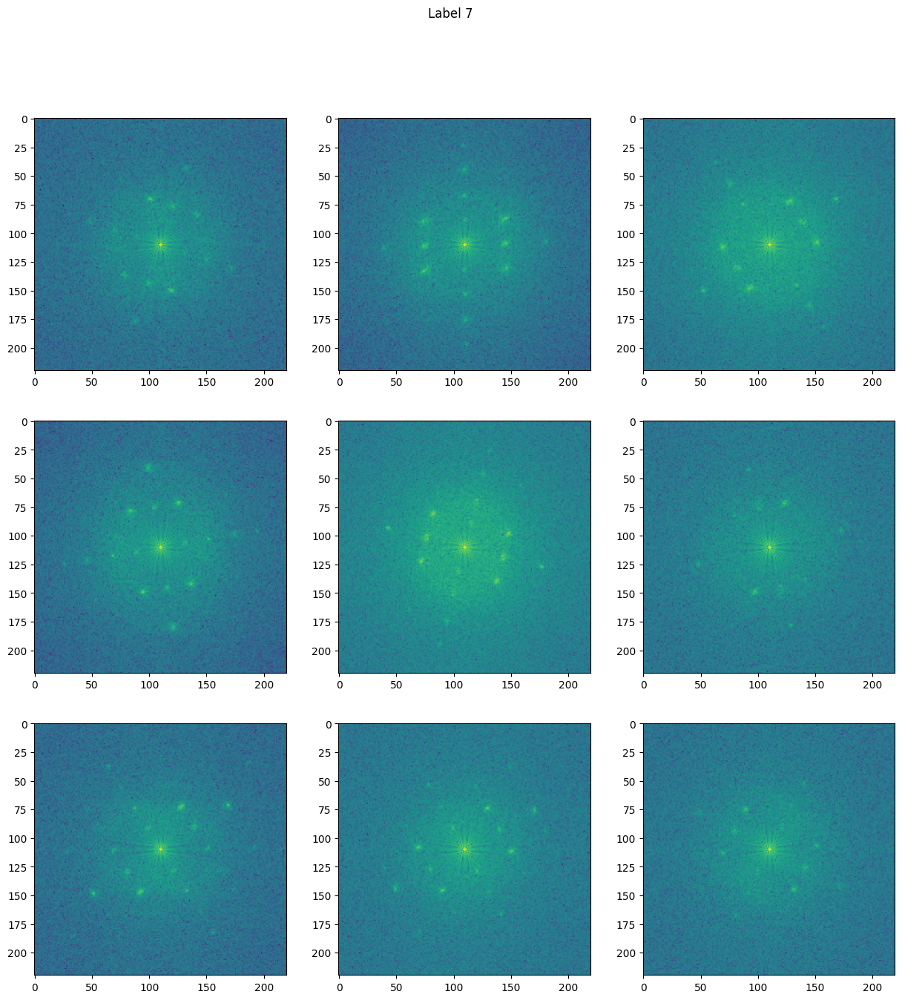

In [4]:
# Now, checking ffts
fig, ax = plt.subplots(3,3, figsize = (15,15))
ax = ax.flatten()
for i in range(9):
    ax[i].imshow(np.log(ffts_oi[i]))
    fig.suptitle('Label ' + str(selected_label))

ideal shift = 102


/tmp/ipykernel_7825/542850054.py:36: RuntimeWarning: divide by zero encountered in log
  ax[0].imshow(np.log(img))
/tmp/ipykernel_7825/542850054.py:37: RuntimeWarning: divide by zero encountered in log
  ax[1].imshow(np.log(img2))
/tmp/ipykernel_7825/542850054.py:38: RuntimeWarning: divide by zero encountered in log
  ax[2].imshow(np.log(rotated_img))
/tmp/ipykernel_7825/542850054.py:50: RuntimeWarning: divide by zero encountered in log
  ax[2].imshow(np.log(fft_aligned))


Text(0.5, 1.0, 'rotated_img2')

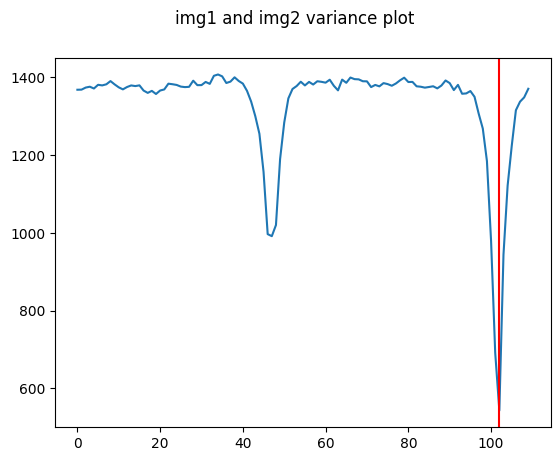

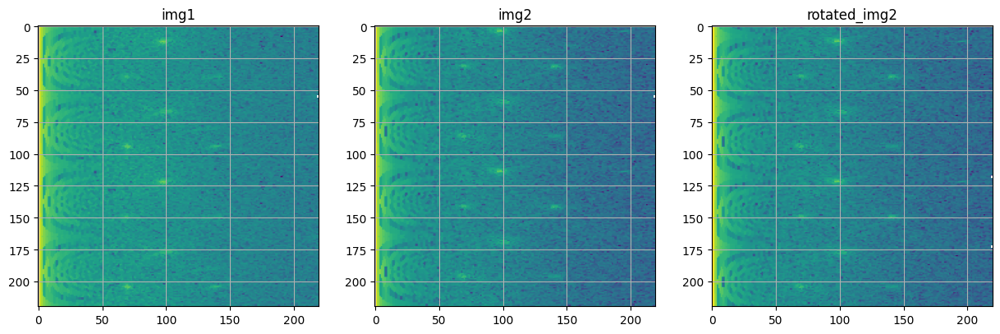

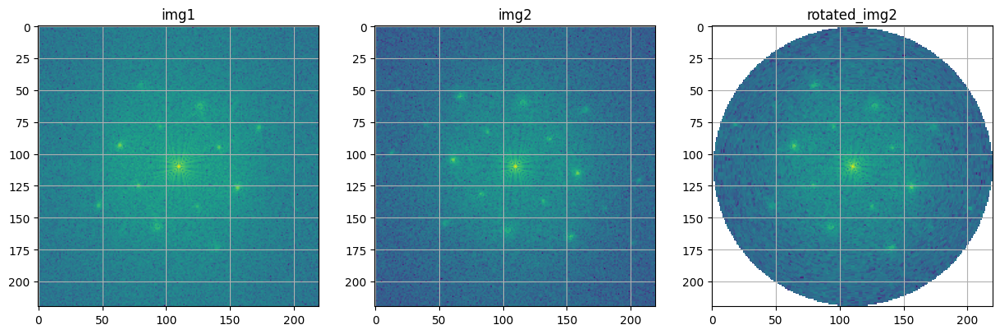

In [5]:
# Testing
ffts_oi_polar = []
for fft in ffts_oi:
    p = linearPolar(fft, (fft.shape[0]/2, fft.shape[1]/2), fft.shape[0]/2, WARP_FILL_OUTLIERS)
    ffts_oi_polar.append(p)
ffts_oi_polar = np.array(ffts_oi_polar)

# Checking variance plot within .shape[0] translation between two imgs
img = ffts_oi_polar[0]
img2 = ffts_oi_polar[1]

vars = []
for shift in range(img.shape[0]//2):
    top_part = img2[:shift, :]
    bottom_part = img2[shift:, :]
    timg2 = np.concatenate((bottom_part, top_part), axis=0)
    var = np.var(img[:,50:]-timg2[:,50:]) # Necessary to discard the low angle range for var calculation
    vars.append(var)
vars = np.array(vars)

ideal_shift = np.argmin(vars)
print('ideal shift =', ideal_shift)

fig,ax = plt.subplots()
ax.plot(vars)
ax.axvline(ideal_shift, c='r')
fig.suptitle('img1 and img2 variance plot')

# Testing vertical translation on both imgs
img = ffts_oi_polar[0]
shift = ideal_shift
top_part = img2[:shift, :]
bottom_part = img2[shift:, :]
rotated_img = np.concatenate((bottom_part, top_part), axis=0)

fig,ax = plt.subplots(1, 3, figsize=(15,5))
ax[0].imshow(np.log(img))
ax[1].imshow(np.log(img2))
ax[2].imshow(np.log(rotated_img))
for i in range(3):
    ax[i].grid()
ax[0].set_title('img1')
ax[1].set_title('img2')
ax[2].set_title('rotated_img2')

fft_aligned = linearPolar(rotated_img, (fft.shape[0]//2,fft.shape[0]//2), fft.shape[0]//2, WARP_INVERSE_MAP | WARP_FILL_OUTLIERS)

fig,ax = plt.subplots(1, 3, figsize=(15,5))
ax[0].imshow(np.log(ffts_oi[0]))
ax[1].imshow(np.log(ffts_oi[1]))
ax[2].imshow(np.log(fft_aligned))
for i in range(3):
    ax[i].grid()
ax[0].set_title('img1')
ax[1].set_title('img2')
ax[2].set_title('rotated_img2')

/tmp/ipykernel_95560/485287727.py:33: RuntimeWarning: divide by zero encountered in log
  ax[i].imshow(np.log(ffts_oi_aligned[i]))


Text(0.5, 0.98, 'Label 7 (aligned)')

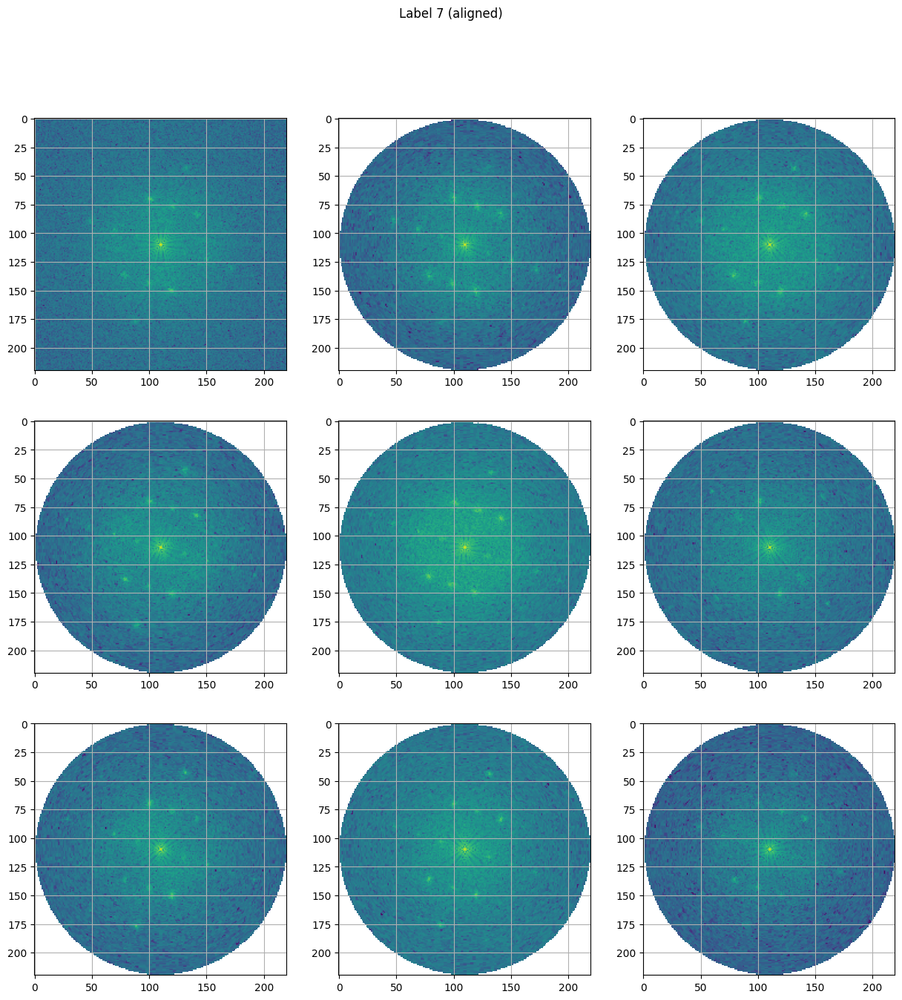

In [5]:
def align_cluster_rotation(cluster):
    ffts_oi_aligned = []

    fft_reference = cluster[0]
    ffts_oi_aligned.append(fft_reference)
    polar_reference = linearPolar(fft_reference, (fft_reference.shape[0]/2, fft_reference.shape[1]/2), fft_reference.shape[0]/2, WARP_FILL_OUTLIERS)
    for fft in cluster[1:]:
        polar = linearPolar(fft, (fft.shape[0]/2, fft.shape[1]/2), fft.shape[0]/2, WARP_FILL_OUTLIERS)

        vars = []
        for shift in range(fft_reference.shape[0]//2):
            top_part = polar[:shift, :]
            bottom_part = polar[shift:, :]
            rotated_polar = np.concatenate((bottom_part, top_part), axis=0)
            var = np.var(polar_reference[:,50:]-rotated_polar[:,50:]) # Necessary to discard the low angle range for var calculation
            vars.append(var)
        vars = np.array(vars)

        shift = np.argmin(vars)
        top_part = polar[:shift, :]
        bottom_part = polar[shift:, :]
        rotated_polar = np.concatenate((bottom_part, top_part), axis=0)

        fft_aligned = linearPolar(rotated_polar, (fft.shape[0]//2,fft.shape[0]//2), fft.shape[0]//2, WARP_INVERSE_MAP | WARP_FILL_OUTLIERS)
        ffts_oi_aligned.append(fft_aligned)
    return np.array(ffts_oi_aligned)

ffts_oi_aligned = align_cluster_rotation(ffts_oi)

fig, ax = plt.subplots(3,3, figsize = (15,15))
ax = ax.flatten()
for i in range(9):
    ax[i].imshow(np.log(ffts_oi_aligned[i]))
    ax[i].grid()
fig.suptitle('Label ' + str(selected_label) + ' (aligned)')

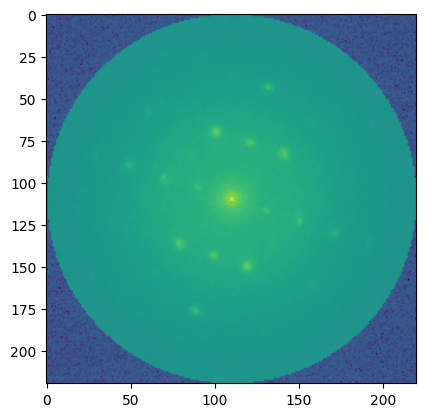

In [6]:
mean_ffts_oi = np.mean(ffts_oi_aligned, axis=0)
plt.imshow(np.log(mean_ffts_oi))

## Applying for all and reconstructing with zero phase

In [6]:
# Loading orientations for titles, just like in last notebook (optimize this later)
orientation_map = np.load('/home/rodrigo.souza/Documents/HRTEM/notebooks/orientation_map.npy', allow_pickle=True)
orientation_map_reshaped = orientation_map.reshape(-1,1,3,3)
orientations = orientation_map_reshaped[:,0,:,2]
orientation_map_corr = np.load('/home/rodrigo.souza/Documents/HRTEM/notebooks/orientation_map_corr.npy')
orientation_map_corr = orientation_map_corr.reshape(-1,1)
orientation_map_corr = orientation_map_corr[:,0]
# Zeroing orientations where corr < thresh
thresh = 1
print('# of orientations:', orientations.shape[0])
print('orientations non [0,0,0]:', np.sum(np.any(orientations != [0,0,0], axis=1)))
orientations[np.where(orientation_map_corr < thresh)] = [0,0,0]
print('orientations non [0,0,0]:', np.sum(np.any(orientations != [0,0,0], axis=1)))

# of orientations: 13225
orientations non [0,0,0]: 12786
orientations non [0,0,0]: 11528


In [7]:
# Creating a array
mean_ffts = []
mean_orientations = []
mean_counts = []
unique_labels, counts = np.unique(labels, return_counts=True)
for i, label in enumerate(unique_labels):
    if label != -1: # eliminating outliers
        label_indices = np.where(labels == label)
        if orientations[label_indices[0]][0].all() != 0: # eliminating non identified ffts. This is definitely not be the most effective way of doing this
            # aligning orientations of clusters
            cluster = ffts[label_indices[0]]
            ffts_cluster_aligned = align_cluster_rotation(cluster)
            mean_ffts.append(np.mean(ffts_cluster_aligned, axis=0))

            # mean orientaions and # of elements for identification
            cluster_or = orientations[label_indices[0]]
            mean_orientations.append(np.mean(cluster_or, axis=0))
            mean_counts.append(counts[i])

mean_ffts = np.array(mean_ffts)
mean_orientations = np.array(mean_orientations)
mean_counts = np.array(mean_counts)

Mean FFTs: # of cluster, (orientation) [# of elements in cluster]


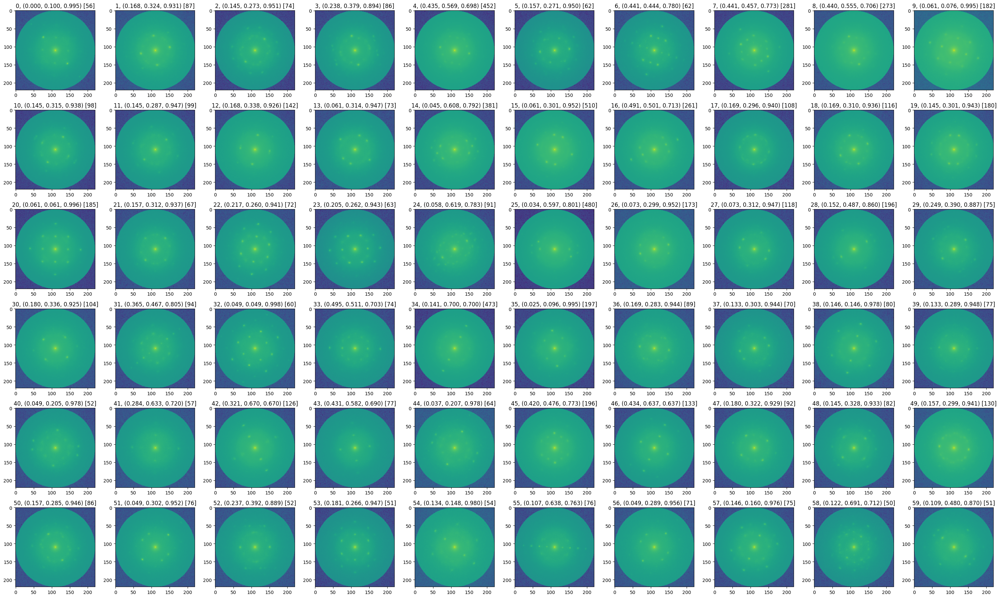

In [8]:
# Checking mean_ffts
fig, ax = plt.subplots(int(len(mean_ffts)/10),10, figsize=(30,int(len(mean_ffts)/10*3)))
ax = ax.flatten()
for i, mean_fft in enumerate(mean_ffts):
    ax[i].imshow(np.log(mean_fft))
    orientation = mean_orientations[i]
    orientation_str = f'({orientation[0]:.3f}, {orientation[1]:.3f}, {orientation[2]:.3f})'
    ax[i].set_title(f'{i}, {orientation_str} [{mean_counts[i]}]')
fig.tight_layout()
print('Mean FFTs: # of cluster, (orientation) [# of elements in cluster]')

Mean particles (zero phase): # of cluster, (orientation) [# of elements in cluster]


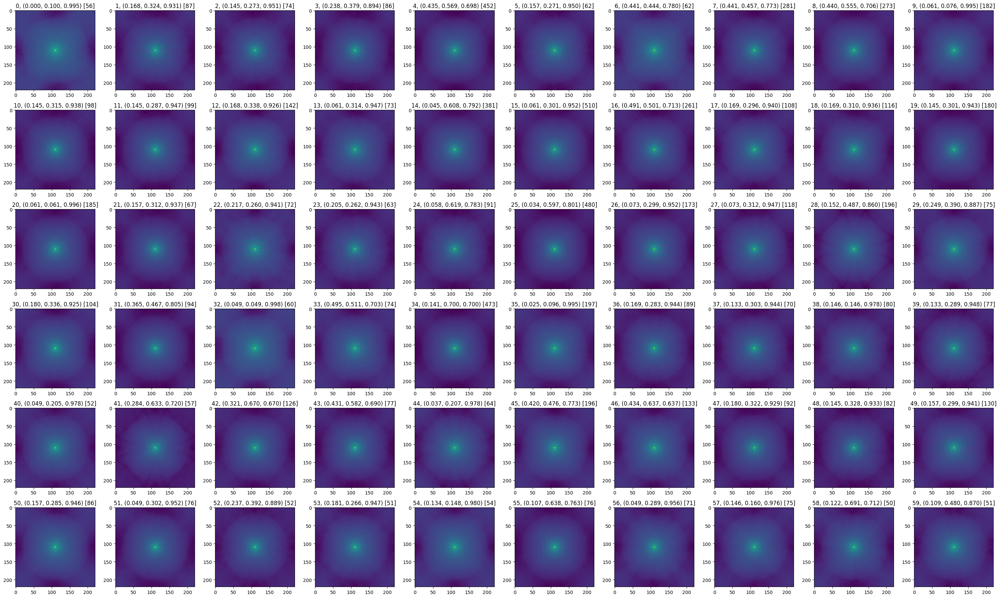

In [9]:
# Checking mean_ffts
fig, ax = plt.subplots(int(len(mean_ffts)/10),10, figsize=(30,int(len(mean_ffts)/10*3)))
ax = ax.flatten()
for i, mean_fft in enumerate(mean_ffts):

    zero_phase_spectrum = np.zeros_like(mean_fft)
    rcrop_zero = np.fft.ifft2(np.fft.ifftshift(np.exp(np.log(mean_fft) + 1j * np.angle(zero_phase_spectrum)))).real
    image_array = rcrop_zero
    width, height = image_array.shape
    mid_x, mid_y = width // 2, height // 2

    # Crop the image into four quadrants using numpy slicing
    top_left = image_array[:mid_y, :mid_x]
    top_right = image_array[:mid_y, mid_x:]
    bottom_left = image_array[mid_y:, :mid_x]
    bottom_right = image_array[mid_y:, mid_x:]

    # Create a new array to combine the quadrants
    new_image_array = np.zeros_like(image_array)

    # Place each quadrant in the new positions (opposite diagonals)
    new_image_array[:mid_y, :mid_x] = bottom_right
    new_image_array[:mid_y, mid_x:] = bottom_left
    new_image_array[mid_y:, :mid_x] = top_right
    new_image_array[mid_y:, mid_x:] = top_left

    ax[i].imshow(np.log(new_image_array))
    orientation = mean_orientations[i]
    orientation_str = f'({orientation[0]:.3f}, {orientation[1]:.3f}, {orientation[2]:.3f})'
    ax[i].set_title(f'{i}, {orientation_str} [{mean_counts[i]}]')

fig.tight_layout()
print('Mean particles (zero phase): # of cluster, (orientation) [# of elements in cluster]')

/tmp/ipykernel_95560/3143725321.py:11: RuntimeWarning: divide by zero encountered in log
  ax[i].imshow(np.log(mean_fft), interpolation='nearest')
/tmp/ipykernel_95560/3143725321.py:17: RuntimeWarning: divide by zero encountered in log
  rcrop_zero = np.fft.ifft2(np.fft.ifftshift(np.exp(np.log(mean_fft) + 1j * np.angle(zero_phase_spectrum)))).real


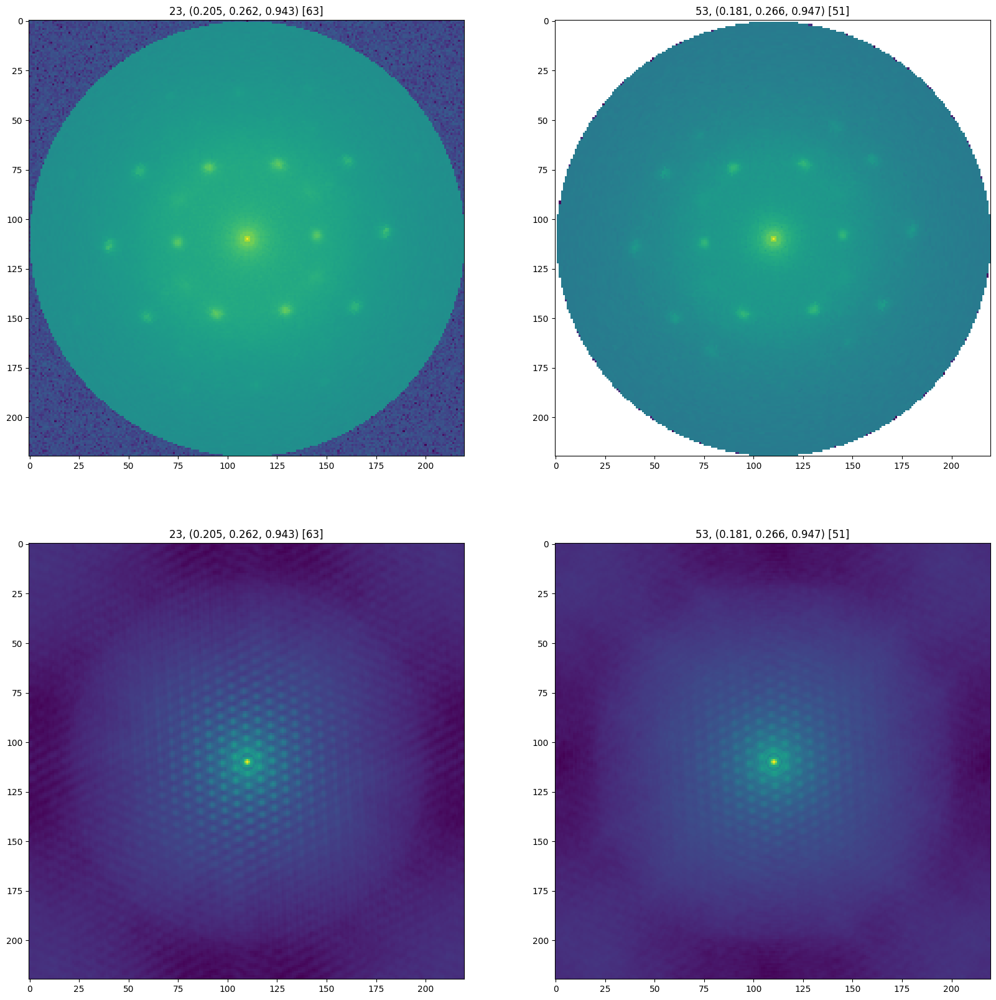

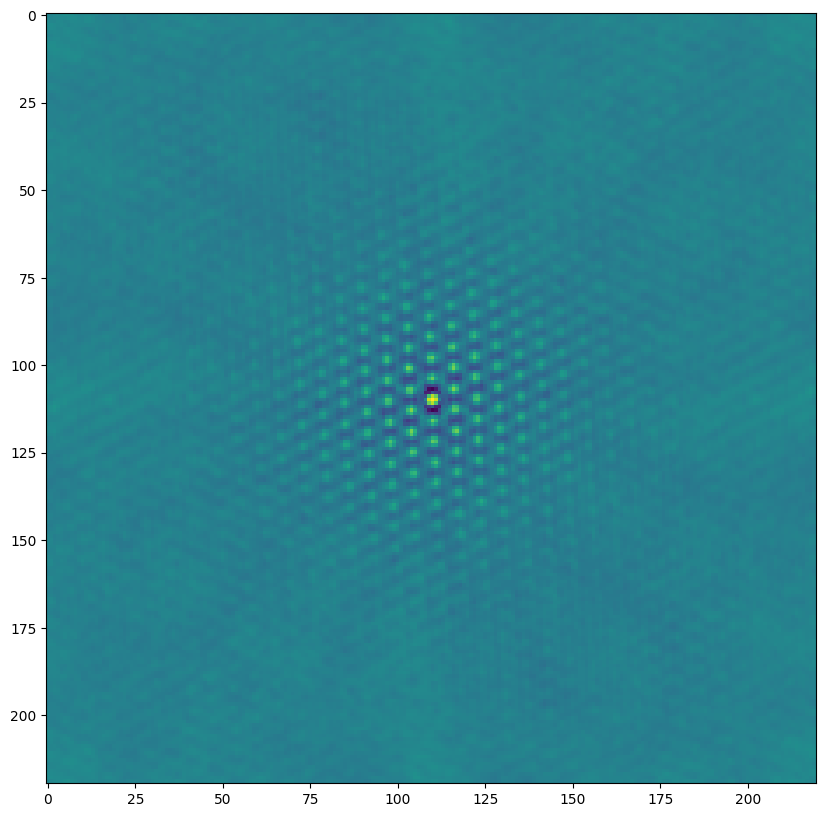

In [37]:
clusters_oi = [23, 53]
# clusters_oi = [6,7]
mean_ffts_oi = mean_ffts[clusters_oi,:,:]
mean_ffts_oi_aligned = align_cluster_rotation(mean_ffts_oi)


fig, ax = plt.subplots(2, int(len(clusters_oi)), figsize=(10*len(clusters_oi),20))
ax = ax.flatten()
reconstructed = []
for i, mean_fft in enumerate(mean_ffts_oi_aligned):
    ax[i].imshow(np.log(mean_fft), interpolation='nearest')
    orientation = mean_orientations[clusters_oi[i]]
    orientation_str = f'({orientation[0]:.3f}, {orientation[1]:.3f}, {orientation[2]:.3f})'
    ax[i].set_title(f'{clusters_oi[i]}, {orientation_str} [{mean_counts[clusters_oi[i]]}]')

    zero_phase_spectrum = np.zeros_like(mean_fft)
    rcrop_zero = np.fft.ifft2(np.fft.ifftshift(np.exp(np.log(mean_fft) + 1j * np.angle(zero_phase_spectrum)))).real
    image_array = rcrop_zero
    width, height = image_array.shape
    mid_x, mid_y = width // 2, height // 2

    # Crop the image into four quadrants using numpy slicing
    top_left = image_array[:mid_y, :mid_x]
    top_right = image_array[:mid_y, mid_x:]
    bottom_left = image_array[mid_y:, :mid_x]
    bottom_right = image_array[mid_y:, mid_x:]

    # Create a new array to combine the quadrants
    new_image_array = np.zeros_like(image_array)

    # Place each quadrant in the new positions (opposite diagonals)
    new_image_array[:mid_y, :mid_x] = bottom_right
    new_image_array[:mid_y, mid_x:] = bottom_left
    new_image_array[mid_y:, :mid_x] = top_right
    new_image_array[mid_y:, mid_x:] = top_left
    reconstructed.append(new_image_array)

    ax[i+len(clusters_oi)].imshow(np.log(new_image_array), interpolation='nearest')
    orientation = mean_orientations[clusters_oi[i]]
    orientation_str = f'({orientation[0]:.3f}, {orientation[1]:.3f}, {orientation[2]:.3f})'
    ax[i+len(clusters_oi)].set_title(f'{clusters_oi[i]}, {orientation_str} [{mean_counts[clusters_oi[i]]}]')

diff = reconstructed[0] - reconstructed[1]
fig,ax = plt.subplots(figsize=(10,10))
ax.imshow(diff)


# (Rascunho) Tests with phases for reconstruction

In [2]:
ffts = np.load('/home/rodrigo.souza/Documents/HRTEM/notebooks/new_outputs/ffts.npy')
fshifts = np.load('/home/rodrigo.souza/Documents/HRTEM/notebooks/new_outputs/fshifts.npy')
rscrops = np.load('/home/rodrigo.souza/Documents/HRTEM/notebooks/new_outputs/rscrops.npy')

In [ ]:
# Manually searching for similar ffts
start = 750
fig,ax = plt.subplots(10,5, figsize=(25,50))
ax = ax.flatten()
for i in range(start, start+50):
    ax[i-start].imshow(np.log(ffts[i]))
    ax[i-start].set_title(f'{i}')

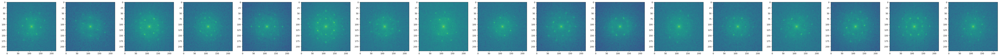

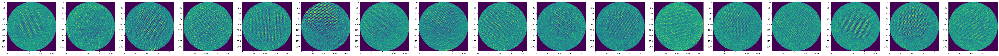

In [39]:
# Found. Displaying.
indexes = [0, 44, 244, 293, 300, 310, 345, 353, 396, 406, 437, 495, 500, 510, 517, 761, 778]
cluster = ffts[indexes]
cluster_fshifts = fshifts[indexes]
cluster_rscrops = rscrops[indexes]

fig,ax = plt.subplots(1,len(cluster), figsize=(len(cluster)*5,5))
ax = ax.flatten()
for i in range(len(cluster)):
    ax[i].imshow(np.log(cluster[i]))
fig,ax = plt.subplots(1,len(cluster), figsize=(len(cluster)*5,5))
ax = ax.flatten()
for i in range(len(cluster)):
    rcrop = np.fft.ifft2(np.fft.ifftshift(np.exp(np.log(cluster[i]) + 1j * np.angle(cluster_fshifts[i])))).real
    ax[i].imshow(rcrop)

### Rotation

/tmp/ipykernel_12398/1021128292.py:48: RuntimeWarning: divide by zero encountered in log
  ax[i].imshow(np.log(ffts_oi_aligned[i]))


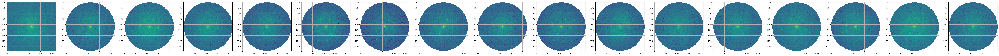

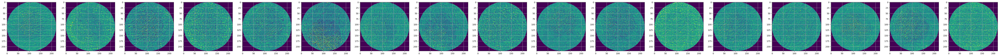

In [130]:
def align_cluster_rotation(cluster):
    ffts_oi_aligned = []
    rscrops_aligned = []

    fft_reference = cluster[0]
    ffts_oi_aligned.append(fft_reference)
    rscrops_aligned.append(cluster_rscrops[0])

    polar_reference = linearPolar(fft_reference, (fft_reference.shape[0]/2, fft_reference.shape[1]/2), fft_reference.shape[0]/2, WARP_FILL_OUTLIERS)
    for i, fft in enumerate(cluster):
        if i != 0:
            polar = linearPolar(fft, (fft.shape[0]/2, fft.shape[1]/2), fft.shape[0]/2, WARP_FILL_OUTLIERS)

            vars = []
            for shift in range(fft_reference.shape[0]//2):
                top_part = polar[:shift, :]
                bottom_part = polar[shift:, :]
                rotated_polar = np.concatenate((bottom_part, top_part), axis=0)
                var = np.var(polar_reference[:,50:]-rotated_polar[:,50:]) # Necessary to discard the low angle range for var calculation
                vars.append(var)
            vars = np.array(vars)

            # Appending alined fft
            shift = np.argmin(vars)
            top_part = polar[:shift, :]
            bottom_part = polar[shift:, :]
            rotated_polar = np.concatenate((bottom_part, top_part), axis=0)
            fft_aligned = linearPolar(rotated_polar, (fft.shape[0]//2,fft.shape[0]//2), fft.shape[0]//2, WARP_INVERSE_MAP | WARP_FILL_OUTLIERS)
            ffts_oi_aligned.append(fft_aligned)

            # Appending aligned rscrop
            polar = linearPolar(cluster_rscrops[i], (fft.shape[0]/2, fft.shape[1]/2), fft.shape[0]/2, WARP_FILL_OUTLIERS)
            shift = np.argmin(vars)
            top_part = polar[:shift, :]
            bottom_part = polar[shift:, :]
            rotated_polar = np.concatenate((bottom_part, top_part), axis=0)
            rscrop_aligned= linearPolar(rotated_polar, (fft.shape[0]//2,fft.shape[0]//2), fft.shape[0]//2, WARP_INVERSE_MAP | WARP_FILL_OUTLIERS)
            # rscrop_aligned = np.fft.ifft2(np.fft.ifftshift(np.exp(np.log(fft_aligned) + 1j * np.angle(cluster_fshifts[i])))).real # Trying to combine rotated fft with original phase, instead of rotating rscrop
            rscrops_aligned.append(rscrop_aligned)

    return np.array(ffts_oi_aligned), np.array(rscrops_aligned)

ffts_oi_aligned, rscrops_aligned = align_cluster_rotation(cluster)

fig,ax = plt.subplots(1,len(cluster), figsize=(len(cluster)*5,5))
ax = ax.flatten()
for i in range(len(cluster)):
    ax[i].imshow(np.log(ffts_oi_aligned[i]))
    ax[i].grid()
fig,ax = plt.subplots(1,len(cluster), figsize=(len(cluster)*5,5))
ax = ax.flatten()
for i in range(len(cluster)):
    ax[i].imshow((rscrops_aligned[i]))
    ax[i].grid()

17


Text(0.5, 1.0, 'mean aligned rscrops')

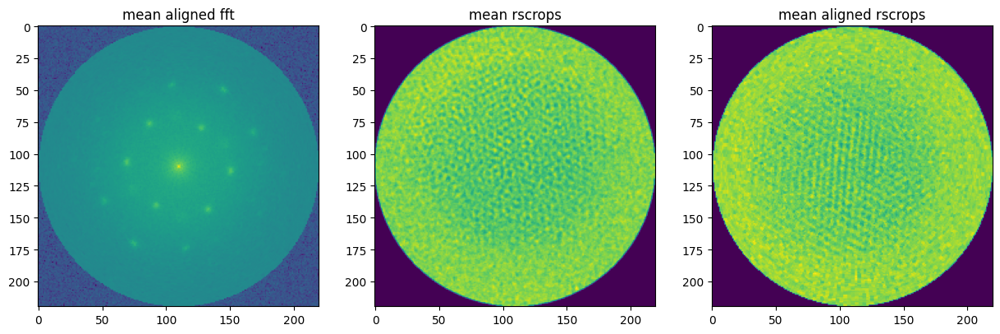

In [137]:
print(len(ffts_oi_aligned))
mean_fft = np.mean(ffts_oi_aligned, axis=0)
fig, ax = plt.subplots(1,3, figsize=(15,5))
ax[0].imshow(np.log(mean_fft))
ax[1].imshow(np.mean(cluster_rscrops, axis=0))
ax[2].imshow(np.mean(rscrops_aligned, axis=0))
ax[0].set_title('mean aligned fft')
ax[1].set_title('mean rscrops')
ax[2].set_title('mean aligned rscrops')

### Testing reconstruction with different forms of phases

Text(0.5, 1.0, 'phase random')

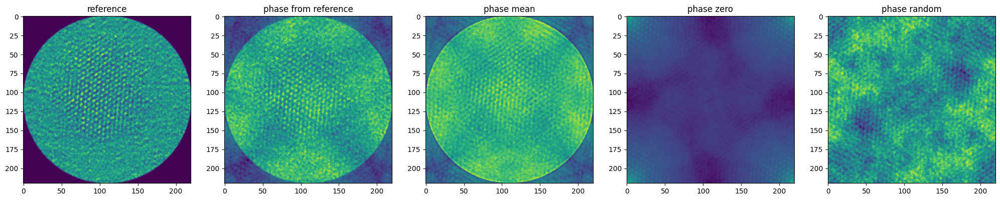

In [146]:
fig, ax = plt.subplots(1,5, figsize=(25,5))    

rcrop_ref = np.fft.ifft2(np.fft.ifftshift(np.exp(np.log(cluster[0]) + 1j * np.angle(cluster_fshifts[0])))).real
ax[0].imshow(rcrop_ref)
ax[0].set_title('reference')

rcrop_phaseref = np.fft.ifft2(np.fft.ifftshift(np.exp(np.log(mean_fft) + 1j * np.angle(cluster_fshifts[0])))).real
ax[1].imshow(rcrop_phaseref)
ax[1].set_title('phase from reference')

rcrop_phasemean = np.fft.ifft2(np.fft.ifftshift(np.exp(np.log(mean_fft) + 1j * np.angle(np.mean(cluster_fshifts, axis=0))))).real
ax[2].imshow(rcrop_phasemean)
ax[2].set_title('phase mean')

zero_phase_spectrum = np.zeros_like(mean_fft)
rcrop_zero = np.fft.ifft2(np.fft.ifftshift(np.exp(np.log(mean_fft) + 1j * np.angle(zero_phase_spectrum)))).real
ax[3].imshow(np.log(rcrop_zero))
ax[3].set_title('phase zero')

random_phase_spectrum = np.random.uniform(-np.pi, np.pi, mean_fft.shape)
rcrop_random = np.fft.ifft2(np.fft.ifftshift(np.exp(np.log(mean_fft) + 1j * np.angle(random_phase_spectrum)))).real
ax[4].imshow((rcrop_random))
ax[4].set_title('phase random')

#### Phase zero?

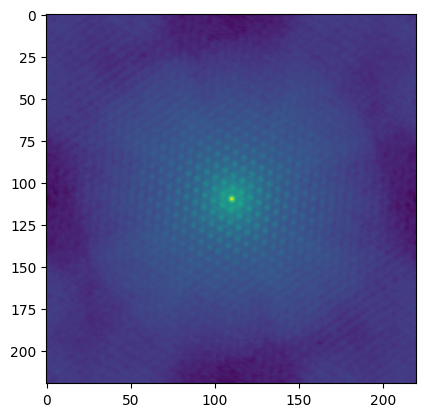

: 

In [172]:
zero_phase_spectrum = np.zeros_like(mean_fft)
rcrop_zero = np.fft.ifft2(np.fft.ifftshift(np.exp(np.log(mean_fft) + 1j * np.angle(zero_phase_spectrum)))).real
image_array = rcrop_zero
width, height = image_array.shape
mid_x, mid_y = width // 2, height // 2

# Crop the image into four quadrants using numpy slicing
top_left = image_array[:mid_y, :mid_x]
top_right = image_array[:mid_y, mid_x:]
bottom_left = image_array[mid_y:, :mid_x]
bottom_right = image_array[mid_y:, mid_x:]

# Create a new array to combine the quadrants
new_image_array = np.zeros_like(image_array)

# Place each quadrant in the new positions (opposite diagonals)
new_image_array[:mid_y, :mid_x] = bottom_right
new_image_array[:mid_y, mid_x:] = bottom_left
new_image_array[mid_y:, :mid_x] = top_right
new_image_array[mid_y:, mid_x:] = top_left

plt.imshow(np.log(new_image_array))

## Messing with phase correlation for translation alignment

In [124]:
import cv2

The most dislocated are 0 and 5

In [147]:
# Manually defining phase correlation
def phase_correlation(ref_image, target_image):

    cpss = []
    # Compute the Fourier transform of both images
    ref_fft = np.fft.fft2(ref_image)
    target_fft = np.fft.fft2(target_image)

    # Compute the cross power spectrum
    cross_power_spectrum = (ref_fft * target_fft.conjugate()) / np.abs(ref_fft * target_fft.conjugate())

    # Apply inverse Fourier transform to the cross power spectrum
    cross_correlation = np.fft.ifft2(cross_power_spectrum)

    # Shift the zero-frequency component to the center of the spectrum
    cross_correlation = np.fft.fftshift(cross_correlation)

    # Find the peak in the cross-correlation
    max_idx = np.unravel_index(np.argmax(np.abs(cross_correlation)), cross_correlation.shape)

    shift_y, shift_x = max_idx[0] - ref_image.shape[0] // 2, max_idx[1] - ref_image.shape[1] // 2

    return shift_x, shift_y

def translate_image(image, tx, ty):
    # Create translation matrix
    M = np.float32([[1, 0, tx], [0, 1, ty]])
    # Apply translation
    translated = cv2.warpAffine(image, M, (image.shape[1], image.shape[0]))
    return translated

# Example usage:
reference_image = rscrops_aligned[0]  # Assuming 'aligned_images' contains images after rotational alignment
final_aligned_images = []
final_aligned_images.append(rscrops_aligned[0])

for i, img in enumerate(rscrops_aligned[1:]):
    shift_x, shift_y = phase_correlation(reference_image, img)
    print('index',i+1, ':', shift_x, shift_y)
    translated_image = translate_image(img, shift_x, shift_y)
    final_aligned_images.append(translated_image)

final_aligned_images = np.array(final_aligned_images)

index 1 : 0 0
index 2 : 0 0
index 3 : 0 0
index 4 : 0 0
index 5 : 0 0
index 6 : 0 0
index 7 : 0 0
index 8 : 0 0
index 9 : 0 0
index 10 : 0 0
index 11 : 0 0
index 12 : 0 0
index 13 : 0 0
index 14 : 0 0
index 15 : 0 0
index 16 : 0 0


In [151]:
# Phase correlation from cv2
def create_circular_mask(h, w, center=None, radius=None):
    if center is None:  # use the middle of the image
        center = (int(w/2), int(h/2))
    if radius is None:  # use the smallest distance between the center and image walls
        radius = min(center[0], center[1], w-center[0], h-center[1])

    Y, X = np.ogrid[:h, :w]
    dist_from_center = np.sqrt((X - center[0])**2 + (Y - center[1])**2)

    mask = dist_from_center <= radius
    return mask

def phase_correlation(ref_image, target_image, mask):

    ref_image = ref_image * mask
    target_image = target_image * mask
    # ref_image[ref_image < 0.1] = 1.3*np.mean(ref_image)
    # target_image[target_image < 0.1] = 1.3*np.mean(target_image)

    shift, response = cv2.phaseCorrelate(ref_image.astype(np.float32), target_image.astype(np.float32))
    return shift[0], shift[1]

def translate_image(image, tx, ty):
    # Create translation matrix
    M = np.float32([[1, 0, tx], [0, 1, ty]])
    # Apply translation
    translated = cv2.warpAffine(image, M, (image.shape[1], image.shape[0]))
    return translated

h, w = rscrops_aligned[0].shape
mask = create_circular_mask(h,w, radius = 110)

# Example usage:
reference_image = rscrops_aligned[0]  # Assuming 'aligned_images' contains images after rotational alignment
final_aligned_images = []
final_aligned_images.append(rscrops_aligned[0])

for i, img in enumerate(rscrops_aligned[1:]):
    shift_x, shift_y = phase_correlation(reference_image, img, mask)
    print('index',i+1, ':', shift_x, shift_y)
    translated_image = translate_image(img, shift_x, shift_y)
    final_aligned_images.append(translated_image)

final_aligned_images = np.array(final_aligned_images)

index 1 : 0.5829609998249055 0.6117197368027973
index 2 : 0.5626146438044657 0.5449261245292973
index 3 : 0.5408210642541604 0.5736635886477899
index 4 : 0.5060983268438264 0.5250347318959143
index 5 : 0.5473260933377588 0.6295400660284258
index 6 : 0.4202023457683026 0.5043608651257045
index 7 : 0.5503399791447521 0.631774327852753
index 8 : 0.46567711282467883 0.5162472639713513
index 9 : 0.4578401379082351 0.4905537139036511
index 10 : 0.509729113441665 0.5361193581613719
index 11 : 0.5505259307506378 0.5952369191773386
index 12 : 0.5334586130413896 0.648618165110534
index 13 : 0.46225057928468516 0.49259916907523404
index 14 : 0.5466816397112666 0.48305027334178874
index 15 : 0.485364917173726 0.5979483636239138
index 16 : 0.5403914882585923 0.60160899845215


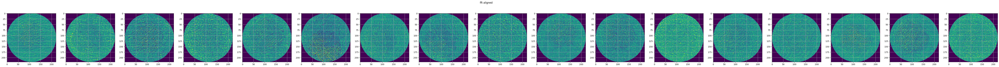

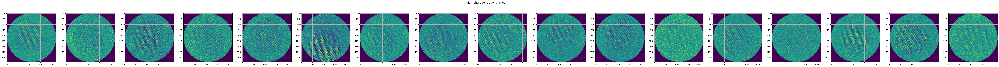

In [149]:
# Plotting the translated crops
fig,ax = plt.subplots(1,len(cluster), figsize=(len(cluster)*5,5))
fig.suptitle('fft aligned')
ax = ax.flatten()
for i in range(len(cluster)):
    ax[i].imshow((rscrops_aligned[i]))
    ax[i].grid()

fig,ax = plt.subplots(1,len(cluster), figsize=(len(cluster)*5,5))
fig.suptitle('fft + phase correlation aligned')
ax = ax.flatten()
for i in range(len(cluster)):
    ax[i].imshow((final_aligned_images[i]))
    ax[i].grid()

### Bin + phase correlation?

In [148]:
from skimage import morphology, filters

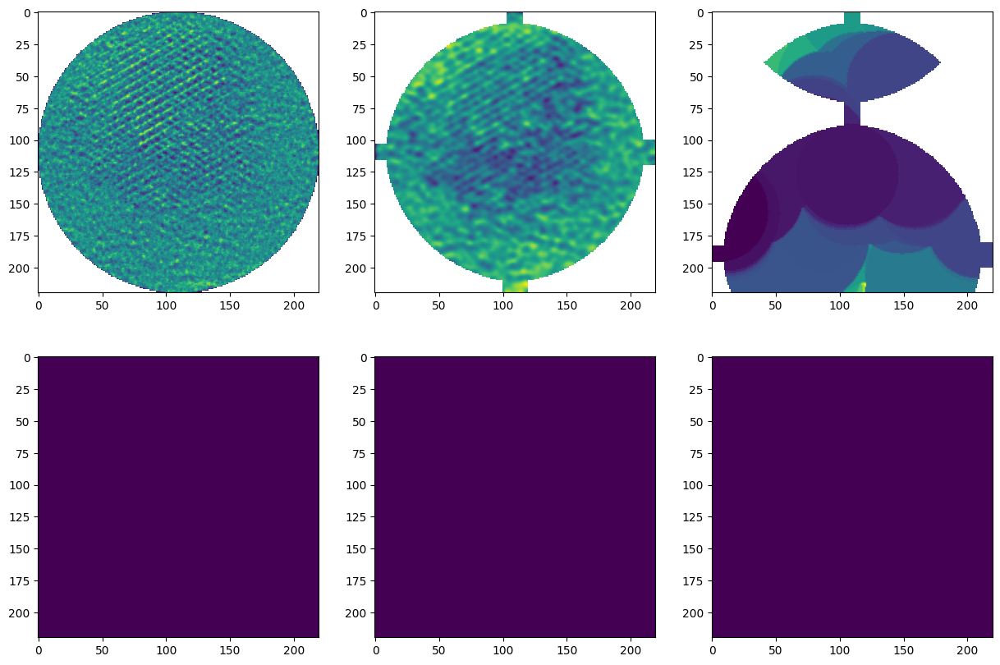

In [170]:
def img_to_segmented_bin(img, adj_disk_size = 40, thresh_block_size = 219, return_info = False): # sizes associados ao tamanho da NP em pixels
    img_copy = img.copy()
    img_copy[img_copy < 0.01] = None
    A = morphology.disk(adj_disk_size)
    fimg = filters.gaussian(img_copy, 2)
    cimg = morphology.closing(fimg, A)
    thresh = filters.threshold_local(cimg, block_size = thresh_block_size, offset = 0.0001)
    bin1 = cimg > thresh
    bin1 = ~bin1
    A2 = morphology.disk(8)
    bin2 = morphology.closing(bin1, A2)
    final_bin = morphology.opening(bin2, A)
    final_bin = morphology.dilation(final_bin, A2)
    
    if return_info:
        return(final_bin, fimg, cimg, bin1, bin2, img_copy)
    else:
        return(final_bin)

i = 7
bin, fimg, cimg, bin1, bin2, img_copy = img_to_segmented_bin(cluster_rscrops[i], return_info = True)

fig,ax = plt.subplots(2,3, figsize=(15,10))
ax[0,0].imshow(img_copy)
ax[0,1].imshow(fimg)
ax[0,2].imshow(cimg)
ax[1,0].imshow(bin1)
ax[1,1].imshow(bin2)
ax[1,2].imshow(bin)